# Clustering of IMU and Odometry Data from TurtleBot3
### By Jacob Laframboise, Jack Demeter
Here we take in a dataset of imu data recorded from the TurtleBot3 Waffle Pi driving on 2 different surfaces at 4 different speeds each, and use K-means clustering to assign each data point to a cluster. Then we use PCA to visualize this high (118) dimension data in 2 or 3 dimensions. Matplotlib is used to plot in 2D, and Plotly is used to plot in 3D interactively, so we can better see the clusters. 

This notebook picks up from where the Python file PreprocessForKmeans.py leaves off, taking in the cleaned dataset. 

In [1]:
# imports
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer

import plotly as ply
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
%matplotlib notebook

pd.set_option('display.max_columns', 120)
pd.set_option('display.max_rows', 80)

## Data Pre-Processing
We load in individual csv files collected from Rosbag on TurtleBot3 with ROS.

In [2]:
# Set to your directory
dataFolder = r"/Users/jessemaccormac/Documents/QMIND/Experiment3Data-2019-11-21"

dataFiles = [
    r"gMitTile_s15_t8.csv",
    r"gMitTile_s15_t9.csv",
    r"gMitTile_s15_t10.csv",
    r"gTurf_s15_t3.csv",
    r"gTurf_s15_t4.csv",
    r"gTurf_s15_t5.csv",
    r"gTurf_s15_t6.csv",
    r"gTurf_s15_t7.csv",
    r"gTurf_s15_t8.csv",
    r"gTurf_s15_t9.csv",
    r"gTurf_s15_t10.csv",
    r"gArcTile_s15_t3.csv",
    r"gArcTile_s15_t4.csv",
    r"gArcTile_s15_t5.csv",
    r"gArcTile_s15_t6.csv",
    r"gArcTile_s15_t7.csv",
    r"gArcTile_s15_t8.csv",
    r"gArcTile_s15_t9.csv",
    r"gArcTile_s15_t10.csv",
    r"gCarp_s15_t3.csv",
    r"gCarp_s15_t4.csv",
    r"gCarp_s15_t5.csv",
    r"gCarp_s15_t6.csv",
    r"gCarp_s15_t7.csv",
    r"gCarp_s15_t8.csv",
    r"gCarp_s15_t9.csv",
    r"gCarp_s15_t10.csv",
    r"gMitTile_s15_t3.csv",
    r"gMitTile_s15_t4.csv",
    r"gMitTile_s15_t5.csv",
    r"gMitTile_s15_t6.csv",
    r"gMitTile_s15_t7.csv"
]

savePath = "Data-32Series-Delta30-Squared.csv"

For each data file we: adjust the index, interpolate NaN values, drop remaining NaN values,  and drop some empty columns.

We then augment the feature space with delta columns and with polynomial columns, and label the columns with terrain, speed, and trial number

In [3]:
for i in range(len(dataFiles)):
    terrain = dataFiles[i].split('_')[0][1:]
    speed = dataFiles[i].split('_s')[1][:2]
    trial = dataFiles[i].split('_t')[1][0]

    df = pd.read_csv(os.path.join(dataFolder, dataFiles[i]))
    df = df.rename(columns={'Unnamed: 0': 'Seq'})
    df = df.set_index('Seq')

    df = df.interpolate(method='polynomial', order=1)

    df = df.dropna()
    df = df.reset_index().drop(columns=['Seq'])
    
    df['OdomPosX'] = df['OdomPosX'] - df['OdomPosX'].loc[0]
    df['OdomPosY'] = df['OdomPosY'] - df['OdomPosY'].loc[0]

    df = df.drop(columns=['OdomPosZ', 'OdomOrientX', 'OdomOrientY', 'OdomLinY', 'OdomLinZ', 'OdomAngX', 'OdomAngY'])
    df['OdomPosXY'] = np.sqrt(df.OdomPosX**2 + df.OdomPosY**2)
    df = df.drop(columns=['OdomPosY', 'OdomPosX'])
    
    order=2
    
    dList = range(1, 302, 20)
    # dList = [2,4,8,16,32,64]
    for col in df.columns.tolist():
        if col!='Sensor':
            for d in dList:
                df[col+'Delta{}'.format(d)] = df[col].diff(d)
                if order>1:
                    for p in range(2, order+1):
                        df[col+'Delta{}Exp{}'.format(d, p)] = df[col+'Delta{}'.format(d)]**p
        else:
            pass

    df = df.iloc[max(dList):].reset_index().drop(columns=['index'])
    df = df.drop(columns=['Sensor', 'Time'])
    df['Speed']=int(speed)
    df['Terrain']=terrain
    df['Trial']=int(trial)

    if i==0:
        mainDf = df.copy(deep=True)
    else:
        mainDf = pd.concat([mainDf, df], axis=0, sort=False)
print("Data series completed")
print("MainDf is now size {}".format(mainDf.shape))

Data series completed
MainDf is now size (145353, 530)


In [4]:
# avoid reloading dataset when working
df = mainDf.copy(deep=True)

In [5]:
df.head()

,OdomOrientZ,OdomOrientW,OdomLinX,OdomAngZ,ImuOrientX,ImuOrientY,ImuOrientZ,ImuOrientW,ImuAngVelX,ImuAngVelY,ImuAngVelZ,ImuAccelX,ImuAccelY,ImuAccelZ,OdomPosXY,TimeDelta1,TimeDelta1Exp2,TimeDelta21,TimeDelta21Exp2,TimeDelta41,TimeDelta41Exp2,TimeDelta61,TimeDelta61Exp2,TimeDelta81,TimeDelta81Exp2,TimeDelta101,TimeDelta101Exp2,TimeDelta121,TimeDelta121Exp2,TimeDelta141,TimeDelta141Exp2,TimeDelta161,TimeDelta161Exp2,TimeDelta181,TimeDelta181Exp2,TimeDelta201,TimeDelta201Exp2,TimeDelta221,TimeDelta221Exp2,TimeDelta241,TimeDelta241Exp2,TimeDelta261,TimeDelta261Exp2,TimeDelta281,TimeDelta281Exp2,TimeDelta301,TimeDelta301Exp2,OdomOrientZDelta1,OdomOrientZDelta1Exp2,OdomOrientZDelta21,OdomOrientZDelta21Exp2,OdomOrientZDelta41,OdomOrientZDelta41Exp2,OdomOrientZDelta61,OdomOrientZDelta61Exp2,OdomOrientZDelta81,OdomOrientZDelta81Exp2,OdomOrientZDelta101,OdomOrientZDelta101Exp2,OdomOrientZDelta121,...,ImuAccelZDelta61Exp2,ImuAccelZDelta81,ImuAccelZDelta81Exp2,ImuAccelZDelta101,ImuAccelZDelta101Exp2,ImuAccelZDelta121,ImuAccelZDelta121Exp2,ImuAccelZDelta141,ImuAccelZDelta141Exp2,ImuAccelZDelta161,ImuAccelZDelta161Exp2,ImuAccelZDelta181,ImuAccelZDelta181Exp2,ImuAccelZDelta201,ImuAccelZDelta201Exp2,ImuAccelZDelta221,ImuAccelZDelta221Exp2,ImuAccelZDelta241,ImuAccelZDelta241Exp2,ImuAccelZDelta261,ImuAccelZDelta261Exp2,ImuAccelZDelta281,ImuAccelZDelta281Exp2,ImuAccelZDelta301,ImuAccelZDelta301Exp2,OdomPosXYDelta1,OdomPosXYDelta1Exp2,OdomPosXYDelta21,OdomPosXYDelta21Exp2,OdomPosXYDelta41,OdomPosXYDelta41Exp2,OdomPosXYDelta61,OdomPosXYDelta61Exp2,OdomPosXYDelta81,OdomPosXYDelta81Exp2,OdomPosXYDelta101,OdomPosXYDelta101Exp2,OdomPosXYDelta121,OdomPosXYDelta121Exp2,OdomPosXYDelta141,OdomPosXYDelta141Exp2,OdomPosXYDelta161,OdomPosXYDelta161Exp2,OdomPosXYDelta181,OdomPosXYDelta181Exp2,OdomPosXYDelta201,OdomPosXYDelta201Exp2,OdomPosXYDelta221,OdomPosXYDelta221Exp2,OdomPosXYDelta241,OdomPosXYDelta241Exp2,OdomPosXYDelta261,OdomPosXYDelta261Exp2,OdomPosXYDelta281,OdomPosXYDelta281Exp2,OdomPosXYDelta301,OdomPosXYDelta301Exp2,Speed,Terrain,Trial
0,0.095387,0.995440,0.148886,-0.006150,-0.004592,-0.004974,-0.104227,-0.994526,0.000000,-0.027669,-0.013835,-0.290297,-0.049081,9.154829,0.280468,0.005092,0.000026,0.130681,0.017078,0.251098,0.063050,0.368369,0.135695,0.493427,0.243470,0.636363,0.404958,0.771192,0.594737,0.892386,0.796352,1.017193,1.034682,1.138310,1.295749,1.258815,1.584615,1.381064,1.907338,1.498555,2.245666,1.625103,2.640961,1.736605,3.015797,1.860827,3.462679,-0.000021,4.593532e-10,-0.000153,2.334641e-08,-0.000206,4.228962e-08,0.000041,1.700049e-09,0.000260,6.770568e-08,0.000506,2.555428e-07,0.000994,...,0.319260,-1.777096,3.158069,0.223260,0.049845,-2.354098,5.541779,-3.133411,9.818267,-1.962646,3.851981,-1.224035,1.498262,-1.312022,1.721402,-0.547673,0.299946,-0.365115,0.133309,0.575208,0.330864,-1.317110,1.734778,-1.399111,1.957512,0.000633,4.004000e-07,0.020527,0.000421,0.037735,0.001424,0.055174,0.003044,0.075799,0.005745,0.097305,0.009468,0.114277,0.013059,0.132897,0.017662,0.153256,0.023487,0.171651,0.029464,0.189526,0.035920,0.207673,0.043128,0.225261,0.050742,0.242993,0.059045,0.259105,0.067135,0.280468,0.078662,15,MitTile,8
1,0.095366,0.995442,0.148886,-0.007478,-0.003933,-0.004679,-0.104174,-0.994536,0.008514,-0.064916,-0.013835,-0.099958,-0.174777,10.842142,0.281100,0.005561,0.000031,0.130839,0.017119,0.251223,0.063113,0.368386,0.135708,0.493495,0.243537,0.634416,0.402483,0.770069,0.593006,0.892173,0.795973,1.017388,1.035079,1.137589,1.294109,1.259750,1.586971,1.380945,1.907008,1.498703,2.246110,1.621436,2.629054,1.735753,3.012839,1.860233,3.460467,-0.000021,4.593532e-10,-0.000181,3.267875e-08,-0.000227,5.162486e-08,-0.000018,3.331765e-10,0.000254,6.460856e-08,0.000447,1.998104e-07,0.000953,...,0.060224,-0.089783,0.008061,1.910573,3.650289,-0.326809,0.106804,0.354342,0.125558,1.449689,2.101598,0.463278,0.214626,0.762553,0.581487,1.201290,1.443098,1.322198,1.748207,1.616685,2.613670,1.389235,1.929975,1.731008,2.996387,0.000633,4.00400

In [6]:
# check for none values and correct size
print(df.isnull().sum().sum()) # check for NaN
df.shape

0


(145353, 530)

## Feature Engineering: Elimination

In [7]:
# eliminate columns derived from time, and from angular velocity
columnsToDrop = [x for x in df.columns.tolist() if 'Time' in x or ('Delta' not in x and 'Speed' not in x and 'Terrain' not in x) ]
df = df.drop(columns=columnsToDrop)

## Kmeans
#### Now that we have processed the data, we can apply Kmeans to cluster it.

In [8]:
doKMeans = True

In [9]:
# separate labels
terrains = df['Terrain']
speeds = df['Speed']
df= df.drop(columns=['Terrain', 'Speed'])

In [10]:
# scale the values for K means
scaler = MinMaxScaler()

scaledFeatures = scaler.fit_transform(df.values)

df = pd.DataFrame(scaledFeatures, columns = df.columns.tolist())

#df = pd.DataFrame(scaler.fit_transform(df))

In [11]:
df.head()

,OdomOrientZDelta1,OdomOrientZDelta1Exp2,OdomOrientZDelta21,OdomOrientZDelta21Exp2,OdomOrientZDelta41,OdomOrientZDelta41Exp2,OdomOrientZDelta61,OdomOrientZDelta61Exp2,OdomOrientZDelta81,OdomOrientZDelta81Exp2,OdomOrientZDelta101,OdomOrientZDelta101Exp2,OdomOrientZDelta121,OdomOrientZDelta121Exp2,OdomOrientZDelta141,OdomOrientZDelta141Exp2,OdomOrientZDelta161,OdomOrientZDelta161Exp2,OdomOrientZDelta181,OdomOrientZDelta181Exp2,OdomOrientZDelta201,OdomOrientZDelta201Exp2,OdomOrientZDelta221,OdomOrientZDelta221Exp2,OdomOrientZDelta241,OdomOrientZDelta241Exp2,OdomOrientZDelta261,OdomOrientZDelta261Exp2,OdomOrientZDelta281,OdomOrientZDelta281Exp2,OdomOrientZDelta301,OdomOrientZDelta301Exp2,OdomOrientWDelta1,OdomOrientWDelta1Exp2,OdomOrientWDelta21,OdomOrientWDelta21Exp2,OdomOrientWDelta41,OdomOrientWDelta41Exp2,OdomOrientWDelta61,OdomOrientWDelta61Exp2,OdomOrientWDelta81,OdomOrientWDelta81Exp2,OdomOrientWDelta101,OdomOrientWDelta101Exp2,OdomOrientWDelta121,OdomOrientWDelta121Exp2,OdomOrientWDelta141,OdomOrientWDelta141Exp2,OdomOrientWDelta161,OdomOrientWDelta161Exp2,OdomOrientWDelta181,OdomOrientWDelta181Exp2,OdomOrientWDelta201,OdomOrientWDelta201Exp2,OdomOrientWDelta221,OdomOrientWDelta221Exp2,OdomOrientWDelta241,OdomOrientWDelta241Exp2,OdomOrientWDelta261,OdomOrientWDelta261Exp2,...,ImuAccelZDelta41,ImuAccelZDelta41Exp2,ImuAccelZDelta61,ImuAccelZDelta61Exp2,ImuAccelZDelta81,ImuAccelZDelta81Exp2,ImuAccelZDelta101,ImuAccelZDelta101Exp2,ImuAccelZDelta121,ImuAccelZDelta121Exp2,ImuAccelZDelta141,ImuAccelZDelta141Exp2,ImuAccelZDelta161,ImuAccelZDelta161Exp2,ImuAccelZDelta181,ImuAccelZDelta181Exp2,ImuAccelZDelta201,ImuAccelZDelta201Exp2,ImuAccelZDelta221,ImuAccelZDelta221Exp2,ImuAccelZDelta241,ImuAccelZDelta241Exp2,ImuAccelZDelta261,ImuAccelZDelta261Exp2,ImuAccelZDelta281,ImuAccelZDelta281Exp2,ImuAccelZDelta301,ImuAccelZDelta301Exp2,OdomPosXYDelta1,OdomPosXYDelta1Exp2,OdomPosXYDelta21,OdomPosXYDelta21Exp2,OdomPosXYDelta41,OdomPosXYDelta41Exp2,OdomPosXYDelta61,OdomPosXYDelta61Exp2,OdomPosXYDelta81,OdomPosXYDelta81Exp2,OdomPosXYDelta101,OdomPosXYDelta101Exp2,OdomPosXYDelta121,OdomPosXYDelta121Exp2,OdomPosXYDelta141,OdomPosXYDelta141Exp2,OdomPosXYDelta161,OdomPosXYDelta161Exp2,OdomPosXYDelta181,OdomPosXYDelta181Exp2,OdomPosXYDelta201,OdomPosXYDelta201Exp2,OdomPosXYDelta221,OdomPosXYDelta221Exp2,OdomPosXYDelta241,OdomPosXYDelta241Exp2,OdomPosXYDelta261,OdomPosXYDelta261Exp2,OdomPosXYDelta281,OdomPosXYDelta281Exp2,OdomPosXYDelta301,OdomPosXYDelta301Exp2
0,0.499963,5.627503e-09,0.499962,5.837011e-09,0.499949,1.057312e-08,0.500010,4.250391e-10,0.500065,1.692740e-08,0.500126,6.388902e-08,0.500249,2.472261e-07,0.500349,4.845021e-07,0.500454,8.222164e-07,0.500524,0.000001,0.500577,0.000001,0.500569,0.000001,0.500583,0.000001,0.500500,0.000001,0.500390,6.096997e-07,0.500440,7.741216e-07,0.496576,6.629933e-07,0.498447,6.549766e-07,0.504208,0.000001,0.512196,4.080037e-08,0.526222,1.432863e-06,0.533671,0.000005,0.542279,0.000016,0.538817,0.000028,0.544470,0.000041,0.528464,0.000052,0.525686,0.000059,0.513664,0.000056,0.511094,0.000057,0.497874,0.000042,...,0.432024,0.008624,0.506281,0.004418,0.338979,0.046200,0.507802,0.000875,0.327976,0.114541,0.258581,0.193007,0.358626,0.078102,0.463108,0.024015,0.410897,0.035521,0.464525,0.005048,0.446072,0.002291,0.534143,0.006166,0.367234,0.024691,0.387781,0.037868,0.00314,0.000002,0.035646,0.001345,0.055029,0.003212,0.069615,0.005140,0.083869,0.007440,0.096271,0.009779,0.102143,0.011016,0.108571,0.012443,0.115837,0.014150,0.128294,0.017378,0.136432,0.019957,0.147528,0.023615,0.149886,0.026925,0.146290,0.029504,0.147535,0.032288,0.148102,0.035860
1,0.499963,5.627503e-09,0.499955,8.170260e-09,0.499944,1.290708e-08,0.499995,8.329942e-11,0.500063,1.615307e-08,0.500111,4.995519e-08,0.500239,2.272351e-07,0.500336,4.508914e-07,0.500446,7.962265e-07,0.500512,0.000001,0.500558,0.000001,0.500562,0.000001,0.500577,0.000001,0.500518,0.000001,0.500379,5.734733e-07,0.500414,6.853779e-07,0.496576,6.629933e-07,0.498522,9.17216

In [12]:
if doKMeans:
    # apply K means clustering
    kmeans = KMeans(n_clusters=4)
    kmeans.fit(df)

In [13]:
if doKMeans:
    labels = kmeans.predict(df)
    centroids = kmeans.cluster_centers_

In [14]:
# add labels back
if doKMeans:
    df['Cluster'] = labels
df['Speed'] = speeds.values
df['Terrain'] = terrains.values

In [15]:
df.head()

,OdomOrientZDelta1,OdomOrientZDelta1Exp2,OdomOrientZDelta21,OdomOrientZDelta21Exp2,OdomOrientZDelta41,OdomOrientZDelta41Exp2,OdomOrientZDelta61,OdomOrientZDelta61Exp2,OdomOrientZDelta81,OdomOrientZDelta81Exp2,OdomOrientZDelta101,OdomOrientZDelta101Exp2,OdomOrientZDelta121,OdomOrientZDelta121Exp2,OdomOrientZDelta141,OdomOrientZDelta141Exp2,OdomOrientZDelta161,OdomOrientZDelta161Exp2,OdomOrientZDelta181,OdomOrientZDelta181Exp2,OdomOrientZDelta201,OdomOrientZDelta201Exp2,OdomOrientZDelta221,OdomOrientZDelta221Exp2,OdomOrientZDelta241,OdomOrientZDelta241Exp2,OdomOrientZDelta261,OdomOrientZDelta261Exp2,OdomOrientZDelta281,OdomOrientZDelta281Exp2,OdomOrientZDelta301,OdomOrientZDelta301Exp2,OdomOrientWDelta1,OdomOrientWDelta1Exp2,OdomOrientWDelta21,OdomOrientWDelta21Exp2,OdomOrientWDelta41,OdomOrientWDelta41Exp2,OdomOrientWDelta61,OdomOrientWDelta61Exp2,OdomOrientWDelta81,OdomOrientWDelta81Exp2,OdomOrientWDelta101,OdomOrientWDelta101Exp2,OdomOrientWDelta121,OdomOrientWDelta121Exp2,OdomOrientWDelta141,OdomOrientWDelta141Exp2,OdomOrientWDelta161,OdomOrientWDelta161Exp2,OdomOrientWDelta181,OdomOrientWDelta181Exp2,OdomOrientWDelta201,OdomOrientWDelta201Exp2,OdomOrientWDelta221,OdomOrientWDelta221Exp2,OdomOrientWDelta241,OdomOrientWDelta241Exp2,OdomOrientWDelta261,OdomOrientWDelta261Exp2,...,ImuAccelZDelta61Exp2,ImuAccelZDelta81,ImuAccelZDelta81Exp2,ImuAccelZDelta101,ImuAccelZDelta101Exp2,ImuAccelZDelta121,ImuAccelZDelta121Exp2,ImuAccelZDelta141,ImuAccelZDelta141Exp2,ImuAccelZDelta161,ImuAccelZDelta161Exp2,ImuAccelZDelta181,ImuAccelZDelta181Exp2,ImuAccelZDelta201,ImuAccelZDelta201Exp2,ImuAccelZDelta221,ImuAccelZDelta221Exp2,ImuAccelZDelta241,ImuAccelZDelta241Exp2,ImuAccelZDelta261,ImuAccelZDelta261Exp2,ImuAccelZDelta281,ImuAccelZDelta281Exp2,ImuAccelZDelta301,ImuAccelZDelta301Exp2,OdomPosXYDelta1,OdomPosXYDelta1Exp2,OdomPosXYDelta21,OdomPosXYDelta21Exp2,OdomPosXYDelta41,OdomPosXYDelta41Exp2,OdomPosXYDelta61,OdomPosXYDelta61Exp2,OdomPosXYDelta81,OdomPosXYDelta81Exp2,OdomPosXYDelta101,OdomPosXYDelta101Exp2,OdomPosXYDelta121,OdomPosXYDelta121Exp2,OdomPosXYDelta141,OdomPosXYDelta141Exp2,OdomPosXYDelta161,OdomPosXYDelta161Exp2,OdomPosXYDelta181,OdomPosXYDelta181Exp2,OdomPosXYDelta201,OdomPosXYDelta201Exp2,OdomPosXYDelta221,OdomPosXYDelta221Exp2,OdomPosXYDelta241,OdomPosXYDelta241Exp2,OdomPosXYDelta261,OdomPosXYDelta261Exp2,OdomPosXYDelta281,OdomPosXYDelta281Exp2,OdomPosXYDelta301,OdomPosXYDelta301Exp2,Cluster,Speed,Terrain
0,0.499963,5.627503e-09,0.499962,5.837011e-09,0.499949,1.057312e-08,0.500010,4.250391e-10,0.500065,1.692740e-08,0.500126,6.388902e-08,0.500249,2.472261e-07,0.500349,4.845021e-07,0.500454,8.222164e-07,0.500524,0.000001,0.500577,0.000001,0.500569,0.000001,0.500583,0.000001,0.500500,0.000001,0.500390,6.096997e-07,0.500440,7.741216e-07,0.496576,6.629933e-07,0.498447,6.549766e-07,0.504208,0.000001,0.512196,4.080037e-08,0.526222,1.432863e-06,0.533671,0.000005,0.542279,0.000016,0.538817,0.000028,0.544470,0.000041,0.528464,0.000052,0.525686,0.000059,0.513664,0.000056,0.511094,0.000057,0.497874,0.000042,...,0.004418,0.338979,0.046200,0.507802,0.000875,0.327976,0.114541,0.258581,0.193007,0.358626,0.078102,0.463108,0.024015,0.410897,0.035521,0.464525,0.005048,0.446072,0.002291,0.534143,0.006166,0.367234,0.024691,0.387781,0.037868,0.00314,0.000002,0.035646,0.001345,0.055029,0.003212,0.069615,0.005140,0.083869,0.007440,0.096271,0.009779,0.102143,0.011016,0.108571,0.012443,0.115837,0.014150,0.128294,0.017378,0.136432,0.019957,0.147528,0.023615,0.149886,0.026925,0.146290,0.029504,0.147535,0.032288,0.148102,0.035860,1,15,MitTile
1,0.499963,5.627503e-09,0.499955,8.170260e-09,0.499944,1.290708e-08,0.499995,8.329942e-11,0.500063,1.615307e-08,0.500111,4.995519e-08,0.500239,2.272351e-07,0.500336,4.508914e-07,0.500446,7.962265e-07,0.500512,0.000001,0.500558,0.000001,0.500562,0.000001,0.500577,0.000001,0.500518,0.000001,0.500379,5.734733e-07,0.500414,6.853779e-07,0.496576,6.629933e-07,0.498522,9.172168e-07,0.504265,0.000001,0.512345,8.172996e-09,0

In [16]:
# alias the PCA function
pca_1d = PCA(n_components=1)
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

In [17]:
# apply PCA on the data for visualization
labelCols = ['Cluster', 'Speed', 'Terrain'] if doKMeans else ['Speed', 'Terrain']
pc1Df = pd.DataFrame(pca_1d.fit_transform(df.drop(columns=labelCols)))
pc2Df = pd.DataFrame(pca_2d.fit_transform(df.drop(columns=labelCols)))
pc3Df = pd.DataFrame(pca_3d.fit_transform(df.drop(columns=labelCols)))

In [18]:
pc1Df.columns = ["PC1_1d"]
pc2Df.columns = ["PC1_2d", "PC2_2d"]
pc3Df.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

In [19]:
pc3Df.head()

,PC1_3d,PC2_3d,PC3_3d
0,-0.742969,0.386635,-0.764161
1,-0.814775,0.391279,-0.723129
2,-0.832888,0.406743,-0.752658
3,-0.842475,0.370178,-0.625198
4,-0.840659,0.338980,-0.528599


In [20]:
# add pca columns to data
df = pd.concat([df, pc1Df, pc2Df, pc3Df], axis=1, join='inner')
df['Zeros']=0

In [21]:
if doKMeans:
    # separate clusters to dataframes
    c0 = df[df['Cluster']==0]
    c1 = df[df['Cluster']==1]
    c2 = df[df['Cluster']==2]
    c3 = df[df['Cluster']==3]

In [22]:
# separate data by actual terrain
tile = df[df['Terrain']=='MitTile']
turf = df[df['Terrain']=='Turf']
arcTile = df[df['Terrain']=='ArcTile']
carp = df[df['Terrain']=='Carp']

In [23]:
if doKMeans:
    # smaller dataframe without all ~100 features
    results = df[['Cluster', 'Terrain', 'Speed']]

In [24]:
if doKMeans:
    # look at which clusters contain mostly one surface or another
    for c in range(4):
        print(c)
        r = results[results.Cluster==c].drop(columns='Speed')
        print(r.groupby('Terrain').count())
        print('\n')

0
         Cluster
Terrain         
ArcTile    11187
Carp        9658
MitTile    10713
Turf       11849


1
         Cluster
Terrain         
ArcTile    12093
Carp       10057
MitTile    10735
Turf       15095


2
         Cluster
Terrain         
ArcTile    13983
Carp        9785
MitTile    11961
Turf       12344


3
         Cluster
Terrain         
Carp        2900
Turf        2993




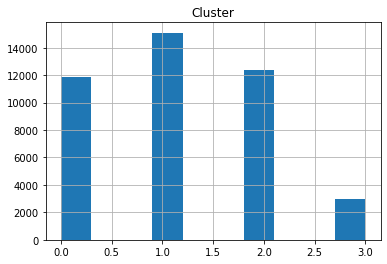

In [25]:
if doKMeans:
    # show which clusters have turf terrain
    results[results['Terrain']=='Turf'].drop(columns='Speed').hist()

## Visualization: PCA components

### 2d Plot of Terrains

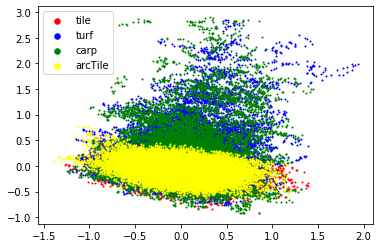

In [26]:
plt.figure()
plt.scatter(x=tile['PC1_2d'], y=tile['PC2_2d'], label='tile', c='red', s=1)
plt.scatter(x=turf['PC1_2d'], y=turf['PC2_2d'], label='turf', c='blue', s=1)
plt.scatter(x=carp['PC1_2d'], y=carp['PC2_2d'], label='carp', c='green', s=1)
plt.scatter(x=arcTile['PC1_2d'], y=arcTile['PC2_2d'], label='arcTile', c='yellow', s=1)
leg = plt.legend()
leg.legendHandles[0]._sizes = [30]
leg.legendHandles[1]._sizes = [30]
leg.legendHandles[2]._sizes = [30]
leg.legendHandles[3]._sizes = [30]

### 2d Plot of Clusters

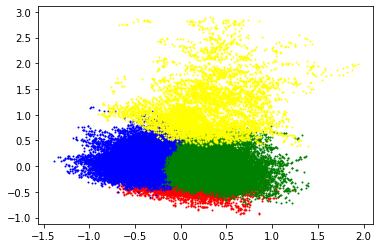

In [27]:
if doKMeans:
    plt.figure()
    plt.scatter(x=c0['PC1_2d'], y=c0['PC2_2d'], c='red', s=1)
    plt.scatter(x=c1['PC1_2d'], y=c1['PC2_2d'], c='blue', s=1)
    plt.scatter(x=c2['PC1_2d'], y=c2['PC2_2d'], c='green', s=1)
    plt.scatter(x=c3['PC1_2d'], y=c3['PC2_2d'], c='yellow', s=1)

In [28]:
init_notebook_mode(connected=True)

### Interactive 3d Plot of Terrains

In [29]:
tilePlot = go.Scatter3d(x=tile['PC1_3d'], y=tile['PC2_3d'], z=tile['PC3_3d'],
               mode="markers", name="Tile",
               marker = dict(color = 'purple'),
               text=None)
turfPlot = go.Scatter3d(x=turf['PC1_3d'], y=turf['PC2_3d'], z=turf['PC3_3d'],
               mode="markers", name="Turf",
               marker = dict(color = 'brown'),
               text=None)
carpPlot = go.Scatter3d(x=carp['PC1_3d'], y=carp['PC2_3d'], z=carp['PC3_3d'],
               mode="markers", name="Carpet",
               marker = dict(color = 'green'),
               text=None)
arcTilePlot = go.Scatter3d(x=arcTile['PC1_3d'], y=arcTile['PC2_3d'], z=arcTile['PC3_3d'],
               mode="markers", name="ArcTile",
               marker = dict(color = 'red'),
               text=None)

plotData = [tilePlot, turfPlot, carpPlot, arcTilePlot]
title = "IMU Clustering Tile vs Turf vs Carpet vs Arc Tile"
layout = dict(title=title, xaxis=dict(title='PC1',ticklen= 5,zeroline= False), yaxis=dict(title= '',ticklen= 5,zeroline= False))

fig2=dict(data=plotData, layout=layout)

In [30]:
iplot(fig2)

In [31]:
if doKMeans:
    # plotly for interactive 3D plot of clusters
    t0 = go.Scatter3d(x=c0['PC1_3d'], y=c0['PC2_3d'], z=c0['PC3_3d'],
                   mode="markers", name="Cluster 0",
                   marker = dict(color = 'purple'),
                   text=None)
    t1 = go.Scatter3d(x=c1['PC1_3d'], y=c1['PC2_3d'], z=c1['PC3_3d'],
                   mode="markers", name="Cluster 1",
                   marker = dict(color = 'brown'),
                   text=None)
    t2 = go.Scatter3d(x=c2['PC1_3d'], y=c2['PC2_3d'], z=c2['PC3_3d'],
                   mode="markers", name="Cluster 2",
                   marker = dict(color = 'grey'),
                   text=None)
    t3 = go.Scatter3d(x=c3['PC1_3d'], y=c3['PC2_3d'], z=c3['PC3_3d'],
                   mode="markers", name="Cluster 3",
                   marker = dict(color = 'blue'),
                   text=None)
    plotData = [t0, t1, t2, t3]
    title = "IMU Clustering with K-Means"
    layout = dict(title=title, xaxis=dict(title='PC1',ticklen= 5,zeroline= False), yaxis=dict(title= '',ticklen= 5,zeroline= False))

    fig=dict(data=plotData, layout=layout)

In [32]:
if doKMeans:
    iplot(fig)

## Results
Applying Kmeans clustering to the IMU data revealed that there was a lot of overlap between the 4 different terrains. While turf and carpet do extend out of the main clustering, forming cluster 2, most of the data is grouped in one area. This indicated that it would be difficult to differentiate between the different terrains based on IMU data readings, and the team decided not to explore further applications initially intended for the data.